# HRI EUV in more detail
## Low Gain, High Gain, and building a Mosaic

We're going to start creating an HRI EUV mosaic from the March 7, 2022 data. The data we are using in this notebook is placed in the ./data_mosaic directory.

Let's first import some packages we are going to use. We are going a bit more low-level here, this time we will avoid SunPy but use opencv, astropy.io and matplotlib. 

In [66]:
%matplotlib notebook

from astropy.io import fits
import numpy as np
import cv2

# And some quick plotting in matplotlib
import matplotlib.pyplot as plt

# That's a good size
plt.rcParams["figure.figsize"] = (10, 10)

We will define a quick helper functions that we will use later in this notebook. This function simply scales and plots a 2d array.

In [67]:
def showimg(data, title, power=1, flip=True):
    """Show a quick preview of the image."""    
    img = data
    if flip:
        img = np.flipud(img)
    if power != 1:
        img[img<0] = 0
        img = np.power(img, power)
    plt.figure()
    imgplot = plt.imshow(img)
    plt.colorbar()
    plt.title(title)
    plt.show()

Let's open one of the files, and see what we are dealing with

<IPython.core.display.Javascript object>


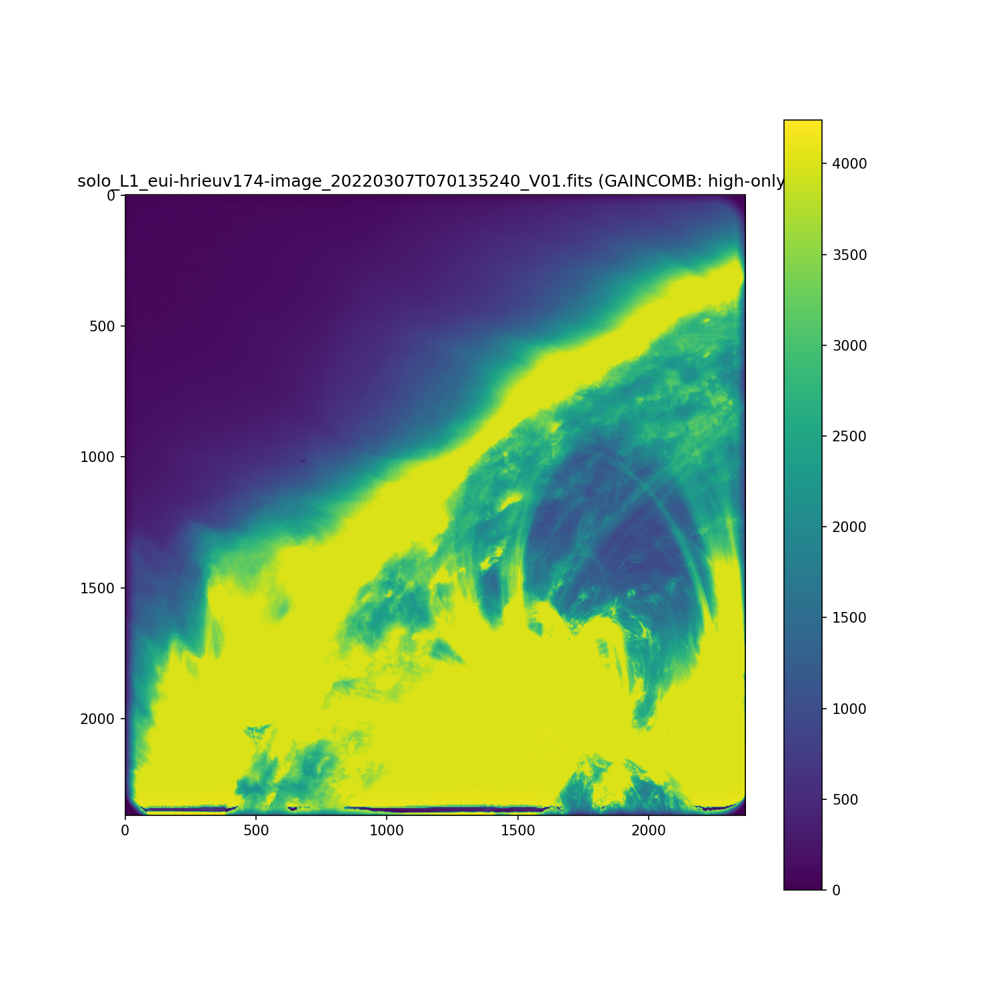

In [68]:
hg = fits.open('./data_mosaic/lights/solo_L1_eui-hrieuv174-image_20220307T070135240_V01.fits')
hg[-1].header['GAINCOMB']

showimg(hg[-1].data, hg[-1].header['FILENAME'] + ' (GAINCOMB: ' + hg[-1].header['GAINCOMB'] + ')')

By looking at the GAINCOMB keyword, we can see that this is a high-gain only image. We typically operate both the FSI and HRI EUV detector in combined gain imaging mode, which means that the low- and high-gain channels coming out of the detector are already combined on-board. In that case, the GAINCOMB keyword will read 'combined'. 

The onboard reconstruction for combined gain images is good, but not perfect and has some limitations in that it only works for images that have a standard size. The standard size for HRI EUV is 2048 x 2048. Let's see what the dimensions are for this image.

In [69]:
hg[-1].header['NAXIS1']

2368

Ah, we are not dealing with a standard size image. You can see this also by the light fall-off towards the edges of the field of view, the normal sized HRI EUV images do not show this vignetting-like effect.

Another thing that stands out in this image, is the dark band at the very bottom of the image. This is a detector artifact, and is occasionally visible in what are in fact the very brightest parts of images in the high-gain channel. It is then mostly visible at the bottom of the image due to the way the detector operates. In these dark areas surrounded by bright areas, the detector is actually erroneously showing low gain pixels.

Because this is a high-gain only image - which is limited to a dynamic range of only 12-bits (0-4095), large parts of the image were too bright and ended up being over-exposed, they do not contain any more details. Due to the way the detector is operated, the clipping in high-gain only images actually occur around a DN of approximately 4015.

When we zoom in in a bit..

<IPython.core.display.Javascript object>


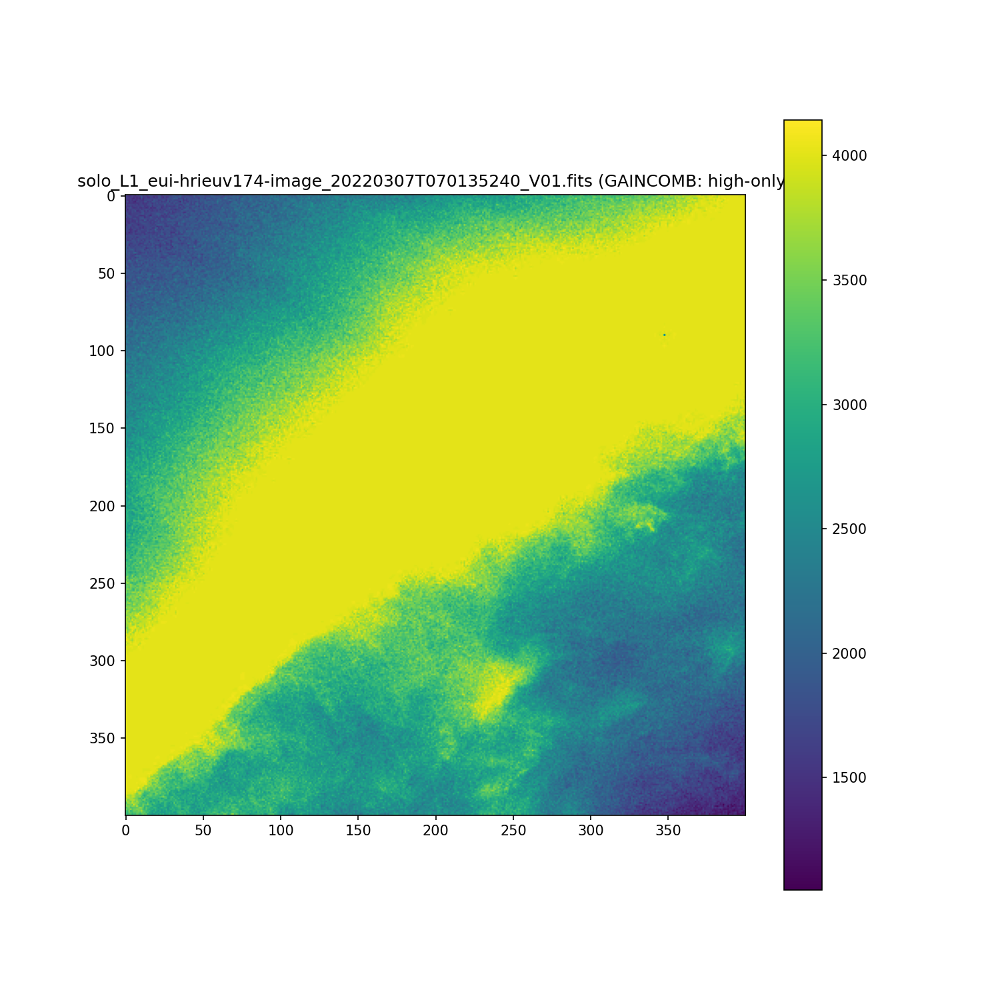

In [70]:
showimg(hg[-1].data[1400:1800,1400:1800], hg[-1].header['FILENAME'] + ' (GAINCOMB: ' + hg[-1].header['GAINCOMB'] + ')')

.. we see that the noise pattern is quite clean looking. There are for example no apparent brightness differences in columns visible (the fixed pattern noise is low, only a few DN in size) 

Let's open a low-gain only image to see what that looks like.

<IPython.core.display.Javascript object>


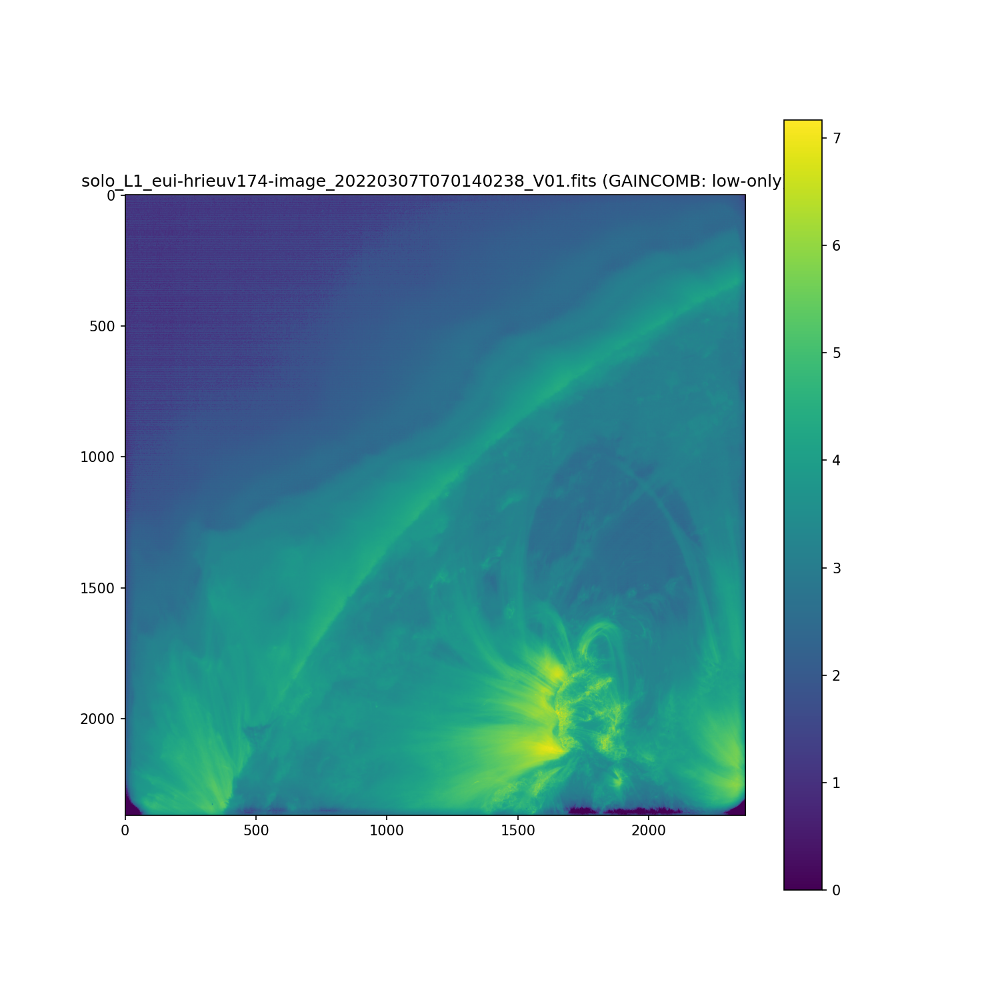

In [71]:
lg = fits.open('./data_mosaic/lights/solo_L1_eui-hrieuv174-image_20220307T070140238_V01.fits')
showimg(lg[-1].data, lg[-1].header['FILENAME'] + ' (GAINCOMB: ' + lg[-1].header['GAINCOMB'] + ')', power=0.25)

We don't have an over-exposed image anymore, but we don't have a lot of details in the dimmer part of the image, and there are strange ringing artifacts which are typical of the low-gain channel.

Now if we zoom in a bit here..

<IPython.core.display.Javascript object>


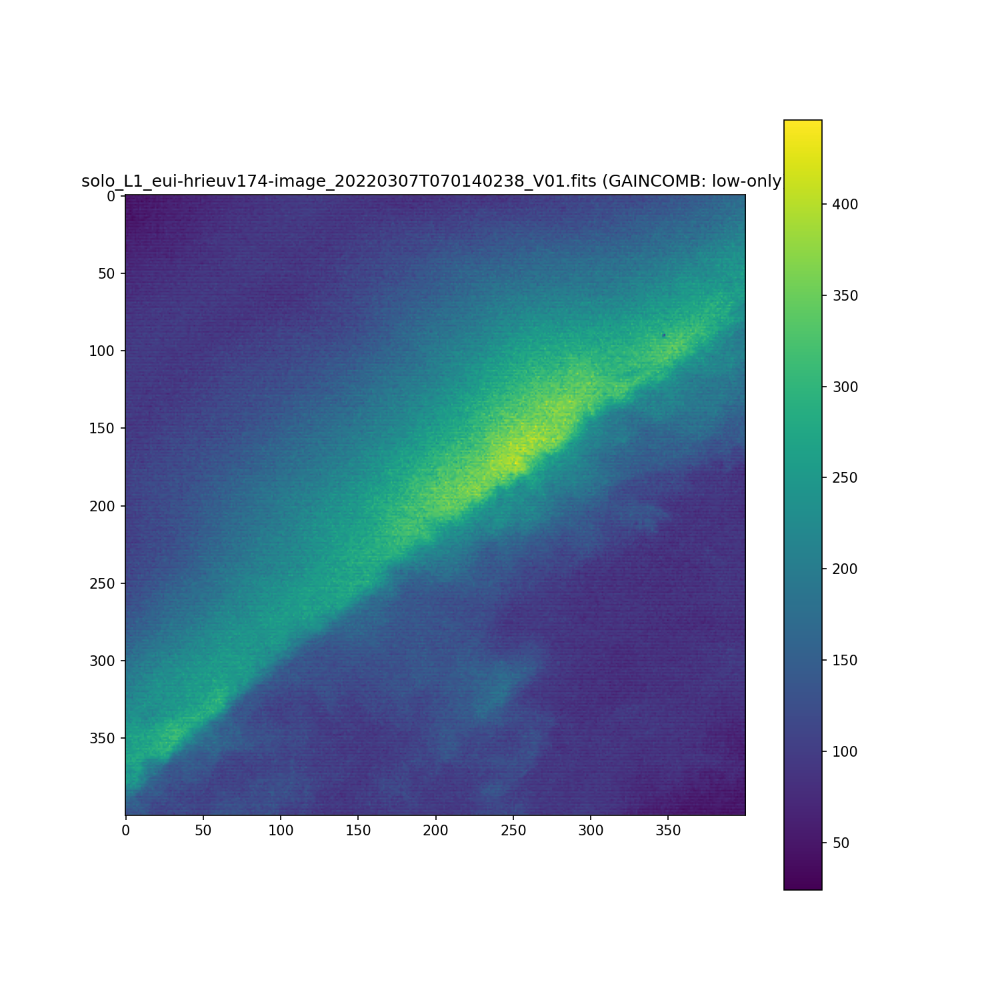

In [72]:
showimg(lg[-1].data[1400:1800,1400:1800], lg[-1].header['FILENAME'] + ' (GAINCOMB: ' + lg[-1].header['GAINCOMB'] + ')')

.. we can see some intensity changes from one row to another (on the detector those are the columns). This fixed pattern noise is much more pronounced in the low-gain channel, but can be calibrated out nicely on ground and also in-flight when we command our instrument to make combined gain images.


Let's try to 'calibrate' this data on-ground to see if we can create a combined gain image manually. For this exercise, we've create a couple of darks and flats that we can use to calibrate these 2368 x 2368 images. (These calibration files are not official and are not part of the euiprep package.) Furthermore, we will create a few helper functions to allow us to create custom bias files to correct for the fixed pattern noise in the low-gain channel.

In [73]:
# We're generating a 4-column offset for the LG image
def generate_bias_column_offsets(offsets, dimensions=2048):
    bias = np.zeros((dimensions, dimensions), dtype=np.float64)
    for i in range(dimensions // 4):
        bias[:,i*4+0] = offsets[0]
        bias[:,i*4+1] = offsets[1]
        bias[:,i*4+2] = offsets[2]
        bias[:,i*4+3] = offsets[3]
    return bias

# Flats
data_flat_hg = fits.open("./data_mosaic/calib/flat_hg.fits")[-1].data.astype(np.float64)
data_flat_lg = fits.open("./data_mosaic/calib/flat_lg.fits")[-1].data.astype(np.float64)

# Darks/bias
data_dark_hg = fits.open("./data_mosaic/calib/dark_hg.fits")[-1].data.astype(np.float64)
data_dark_lg = np.rot90(generate_bias_column_offsets([ 0, 16.9, 4.8, 12.0 ], dimensions=2368)) + 4.0

# The flats aren't very good, we are correcting the 
lg_flat_correction = cv2.imread('./data_mosaic/calib/hd_div_lg.png',0).astype(np.float32)
lg_flat_correction = lg_flat_correction / np.mean(lg_flat_correction)
data_flat_lg = data_flat_lg / lg_flat_correction

Let's have a close look at the resulting darks and flats

<IPython.core.display.Javascript object>


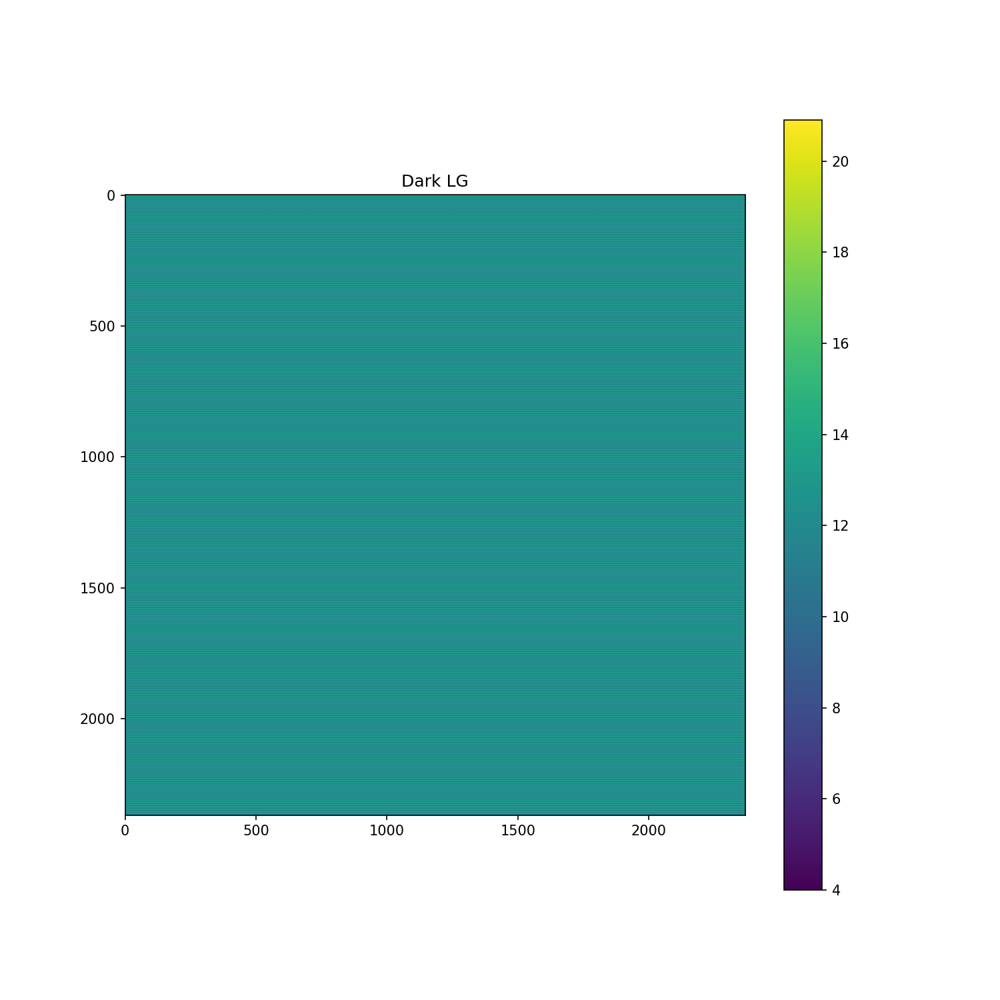

In [74]:
showimg(data_dark_lg, 'Dark LG')

<IPython.core.display.Javascript object>


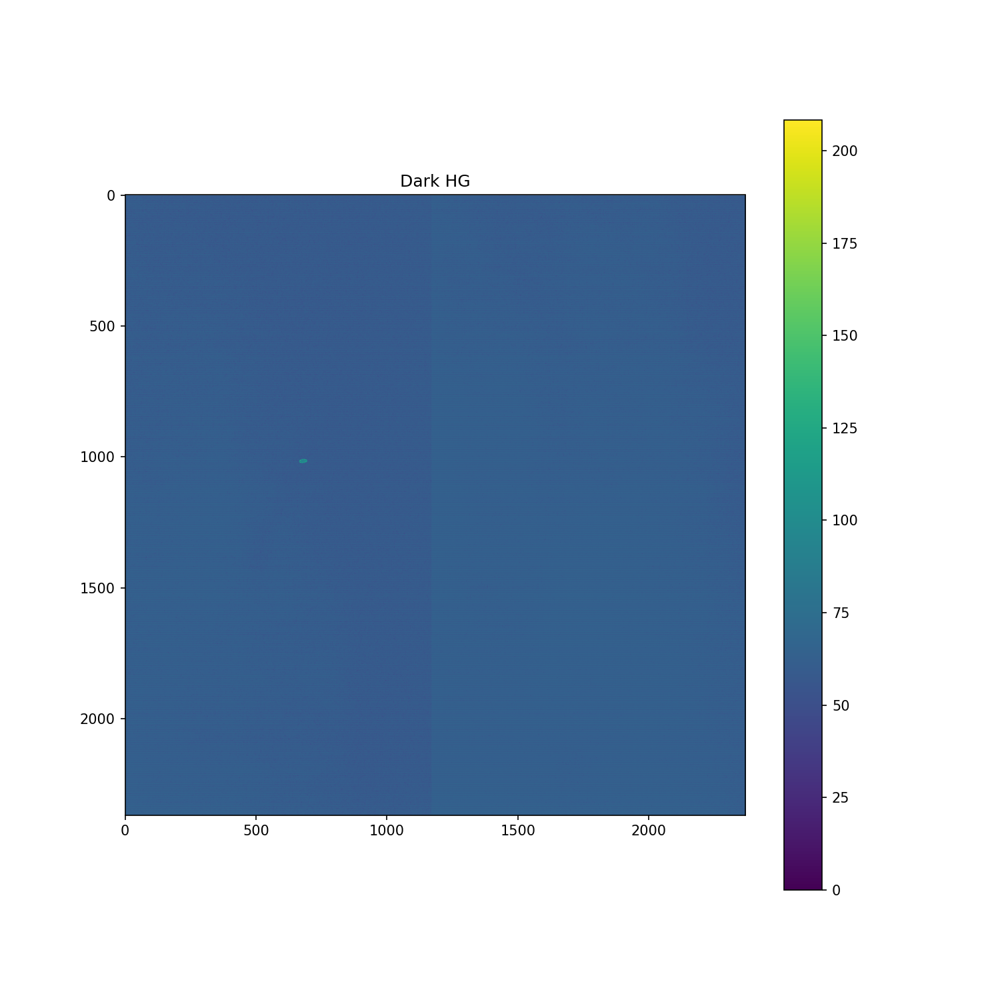

In [75]:
showimg(data_dark_hg, 'Dark HG')

The low-gain dark is just the 4-column offset image that we created, while in the dark for the high-gain image we can also see the stiching line and the gummy bear artifact.

<IPython.core.display.Javascript object>


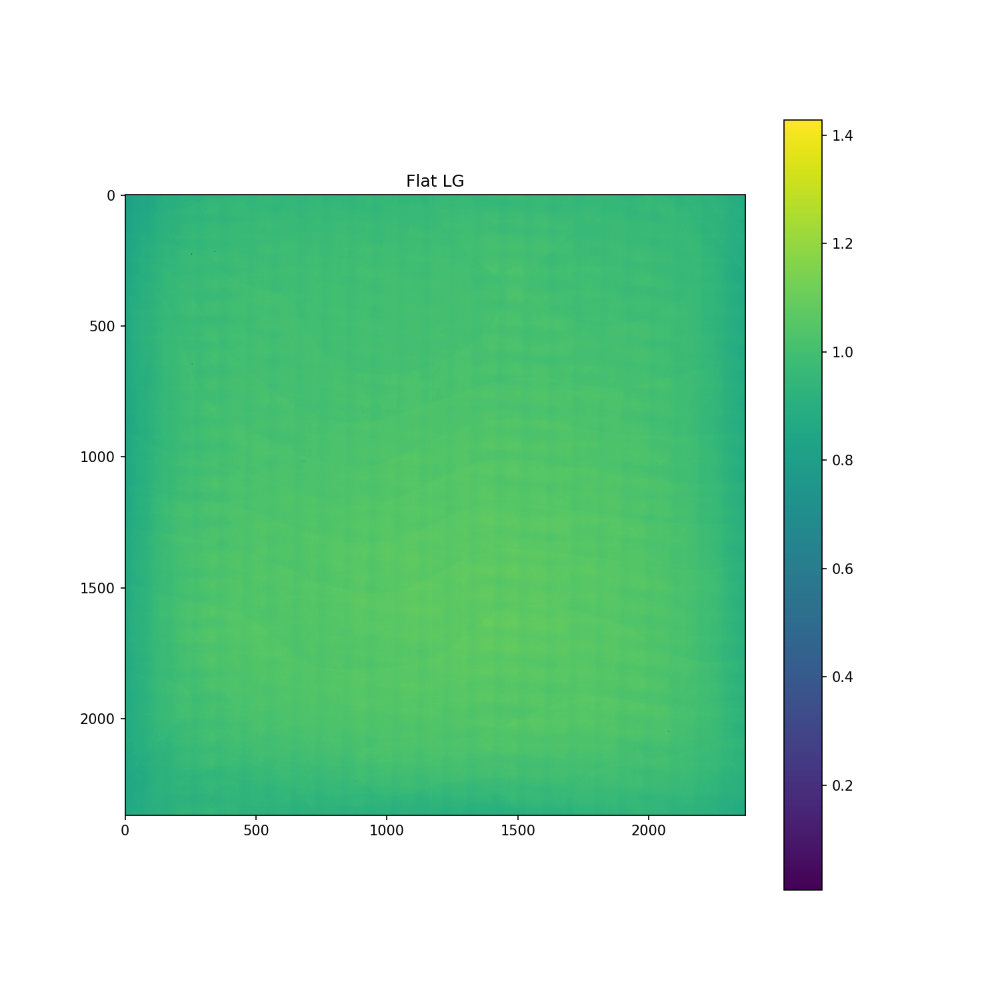

In [76]:
showimg(data_flat_lg, 'Flat LG')

<IPython.core.display.Javascript object>


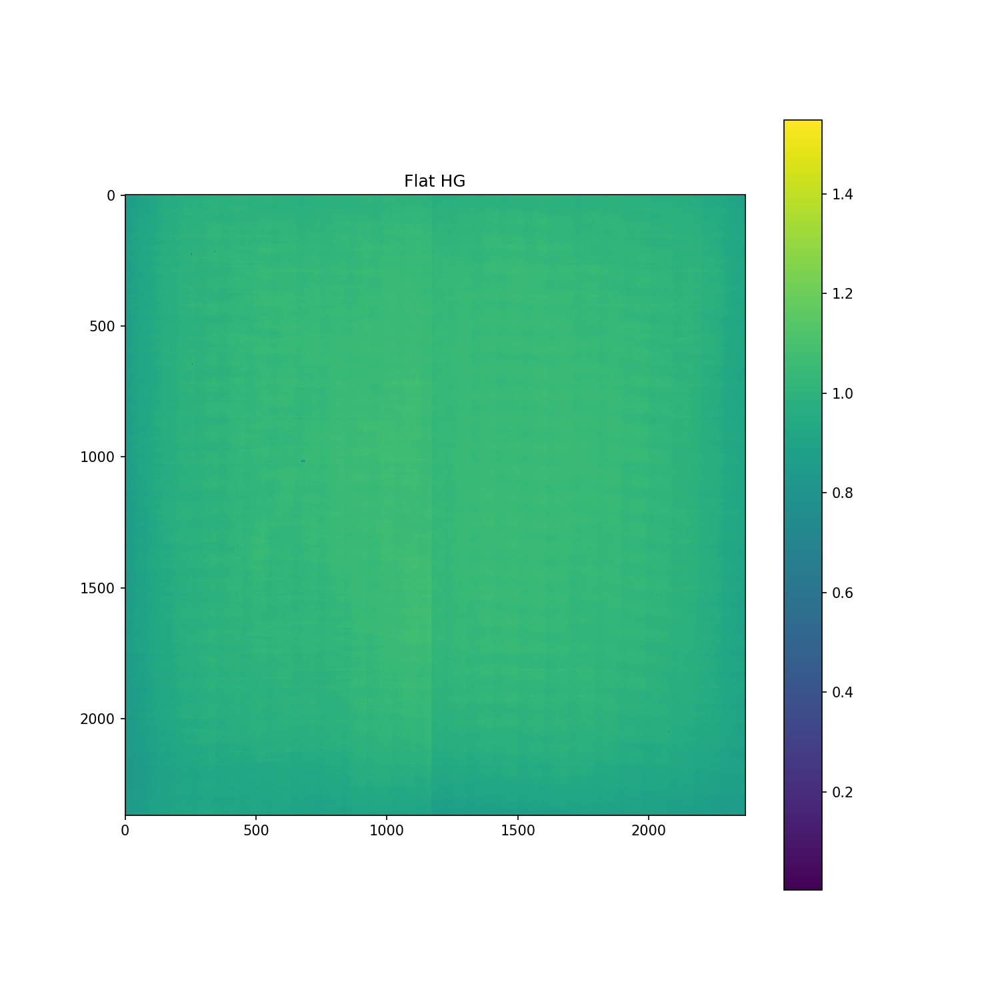

In [77]:
showimg(data_flat_hg, 'Flat HG')

You can see faint waivy pattern in both of the flat fields, and the stiching lines also stand out quite a bit. Finally we can again see the gummy bear. The gummy bear is difficult to correct for, and currently this artifact can be seen in many of the HRI EUV L2 images still.

Let's try to manually 'calibrate' the low-gain image. We subtract the dark signal - which only contains a 4-column offset - and divide the result by the low-gain flat.

<IPython.core.display.Javascript object>


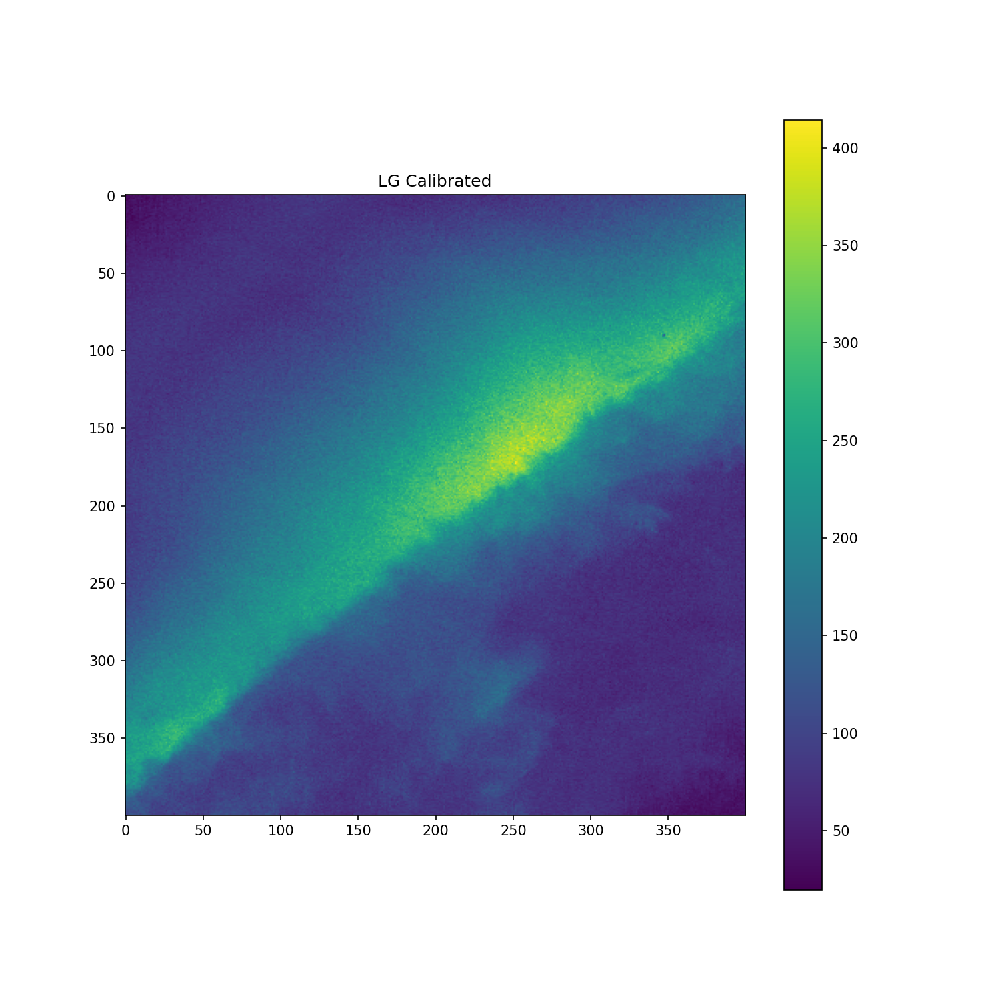

In [78]:
cal_lg = (lg[-1].data.astype(np.float64) - data_dark_lg) / data_flat_lg
showimg(cal_lg[1400:1800,1400:1800], 'LG Calibrated')


The column pattern is gone, the image looks quite smooth. 

We will calibrate the high-gain data in a similar way.

<IPython.core.display.Javascript object>


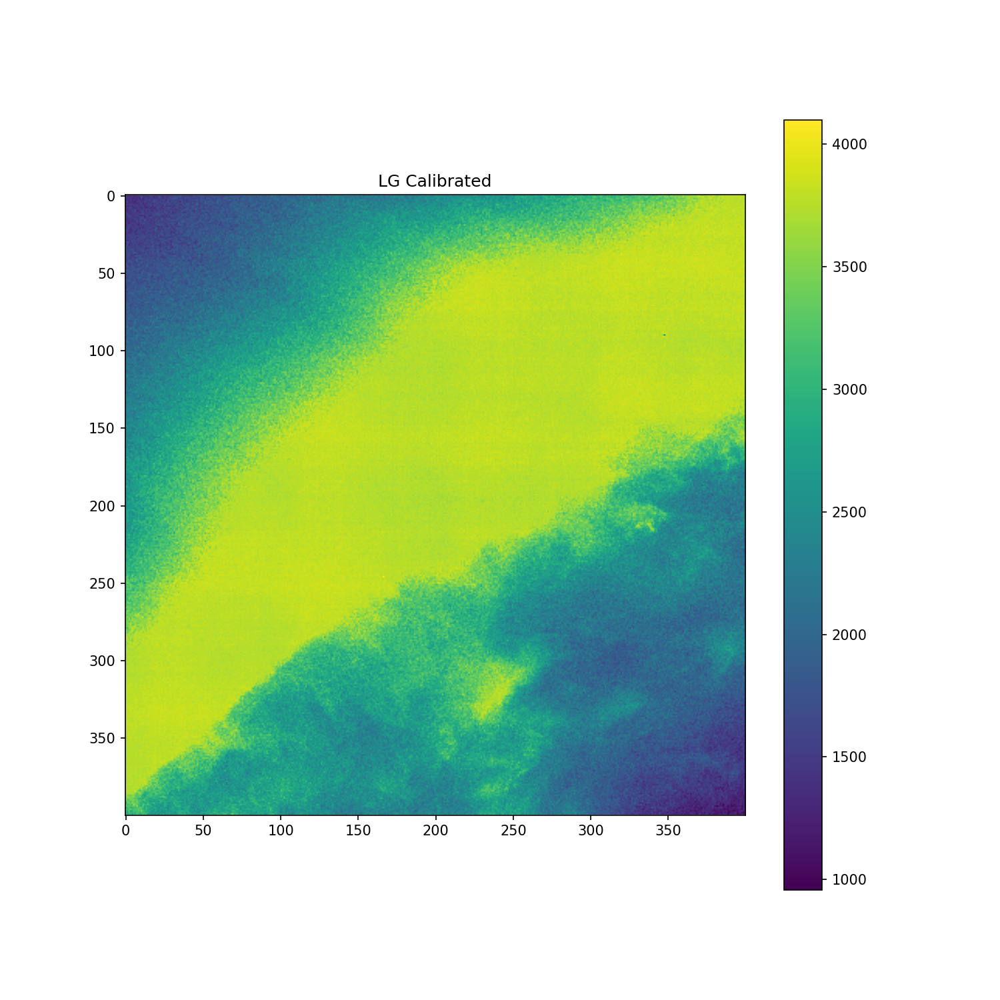

In [79]:
cal_hg = (hg[-1].data.astype(np.float64) - data_dark_hg) / data_flat_hg.astype(np.float64)
showimg(cal_hg[1400:1800,1400:1800], 'LG Calibrated')


We can see a faint pattern of the flat-field now visible in the over-exposed parts of the images. You will see this as well in high-gain only calibrated level 2 HRI EUV fits files. In a future release, we will add a data product that keeps track of the over-exposed pixels such that you can more easily discard these almost over-exposed parts of the images. Right now to know which pixels are over-exposed, you would need to go back to level 1 images and look for pixels above the a certain threshold. 

Let's move on, and try to figure out how to best combine the low-gain and high-gain images into a single high dynamic range image. We will use the image themselves to figure out this gain ratio. To do this, we can only look at pixels that are not over-exposed in the high-gain channel. But because the low-gain image is not very good for lower brightness values, we will use pixels in a very narrow range between a DN of 3900-4000 in the high-gain channel. 

In [80]:
import copy
def find_multiplier(cal_lg, cal_hg):
    div_cal_hg = copy.deepcopy(cal_hg)
    div_cal_hg[cal_hg == 0] = np.nan
    diff = cal_lg / div_cal_hg
    diff[hg[-1].data > 4000] = np.nan
    diff[hg[-1].data < 3900] = np.nan
    return 1/np.nanmean(diff)

lg_multiplier=find_multiplier(cal_lg, cal_hg)
lg_multiplier

24.43721148744797

The low-gain multiplier it found was ~24.4. In practice this is likely a slight under-estimation of the gain ratio, but in for the data used in this tutorial it will look OK. 

We will define a function that combines a low-gain and high-gain image, cleans up a bit of the outer parts of the image, and scales the data in a similar way as this calculation is actually performed on-board of our instrument.

In [81]:
def combine(hg_uncorrected, lg, hg, gain_threshold = 3500, global_gain_hg=72, global_gain_lg=1806):
    # if LG > x, then HG, else LG
    lg_pixels           = hg_uncorrected > gain_threshold
    lg_mask             = lg_pixels * 1.0
    # using a more smooth transition between LG and HG pixels
    lg_mask             = cv2.GaussianBlur(lg_mask,(0,0), 5)
    hg_mask             = 1 - lg_mask

    combined            = hg * global_gain_hg * hg_mask
    combined           += lg * global_gain_lg * lg_mask

    #  Get rid of outer 64 pixels
    combined = combined[64:-64,64:-64]
    combined = combined / 256.0

    return combined

Let's see if it works for the data we just opened, using typical combination values we also use when we do on-board calibration.

<IPython.core.display.Javascript object>


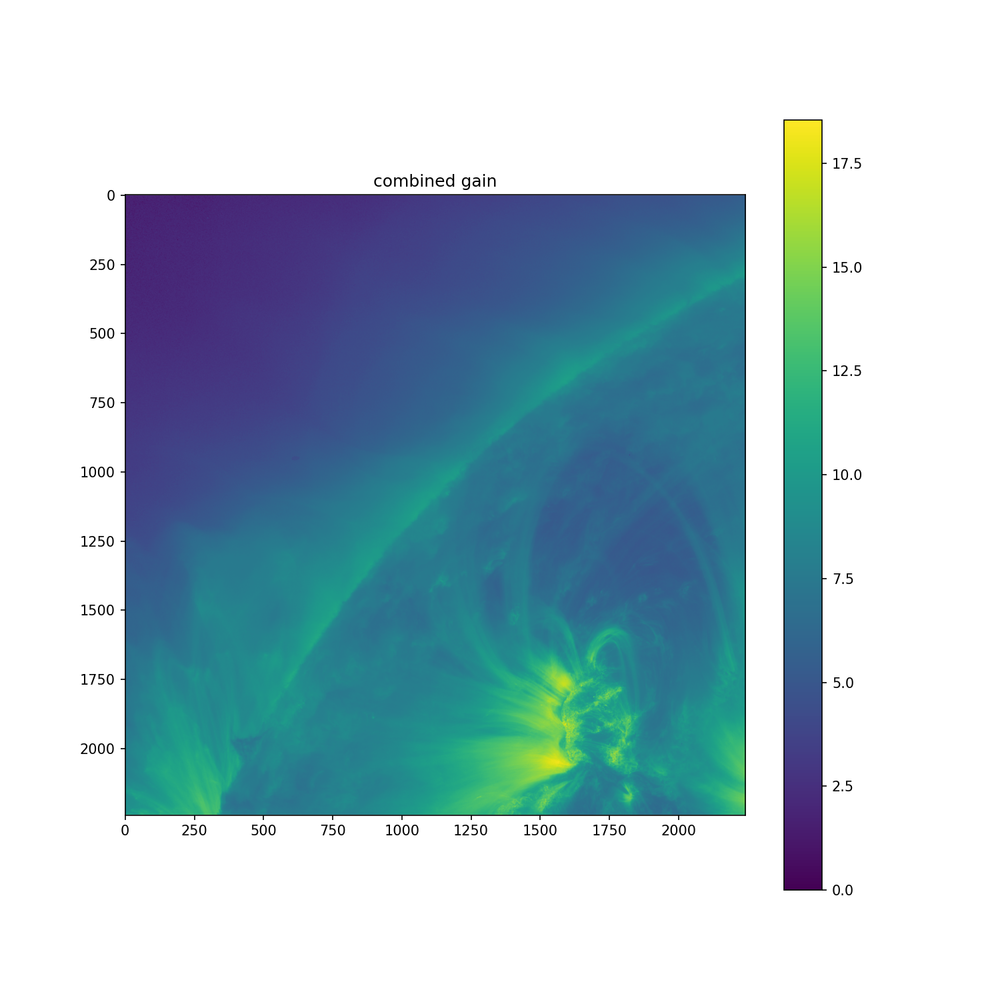

In [82]:
combined = combine(hg[-1].data, cal_lg, cal_hg, gain_threshold=3975, global_gain_hg=72, global_gain_lg=lg_multiplier*72)

showimg(combined, 'combined gain', power=0.3)

That looks quite nice actually! We can see some faint artifacts here or there - in particular the gummy bear that is visible in many of our HRI EUV images - but overall the image appears smooth and it's not easy to detect the high-gain from the low-gain parts!

When zooming in, you'll see the noise characteristic of the low-gain image is different from the high-gain parts. 

<IPython.core.display.Javascript object>


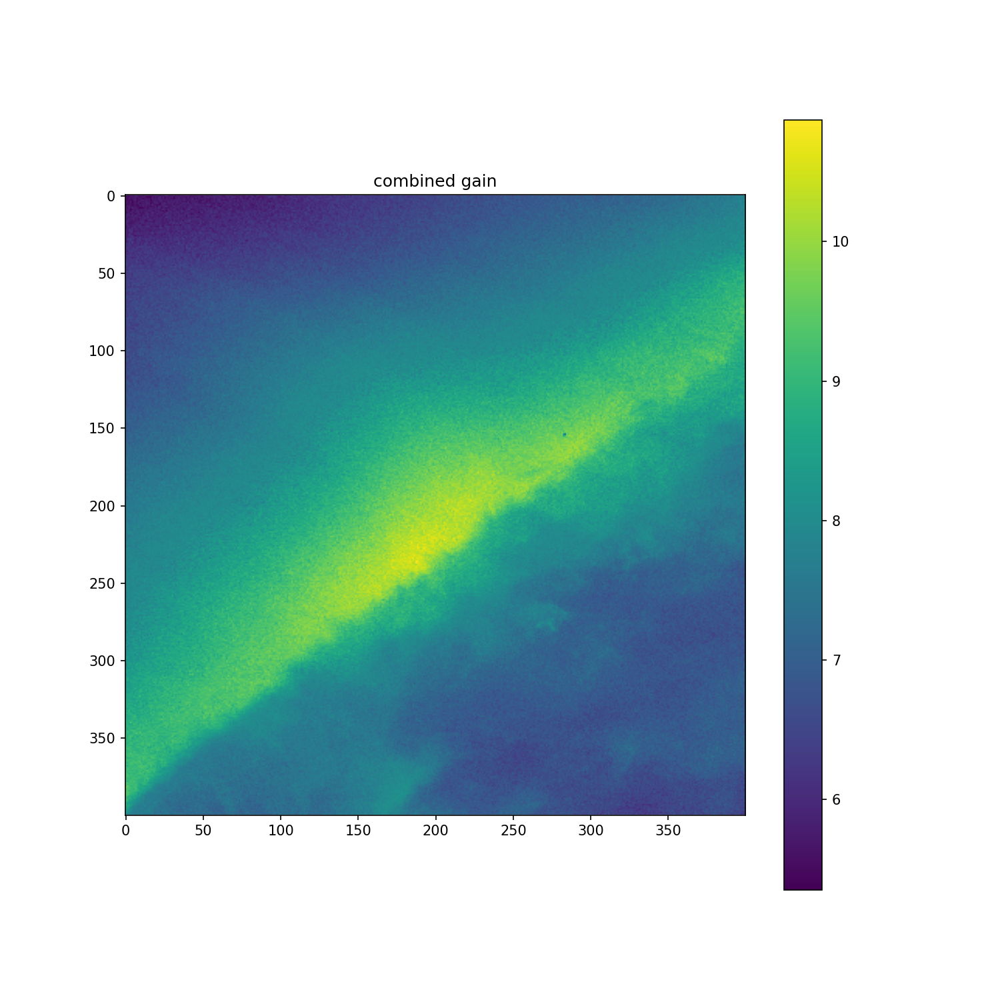

In [83]:
showimg(combined[1400:1800,1400:1800], 'combined gain', power=0.3)

If you look closely you can see that the noise is more pronounced in the low-gain parts of the image than it is in the high-gain parts (this is expected behaviour). You can also see that the low-gain part of the image appears to be a tiny bit too dark compared to the surrounding high-gain parts. This changes a bit throughout the field of view, and this also makes it difficult to combine images on-board where you'll often see a small offset between the low- and high-gain parts of combined gain images.

But despite these small problems, the results look pretty good considering what we started with!

<IPython.core.display.Javascript object>


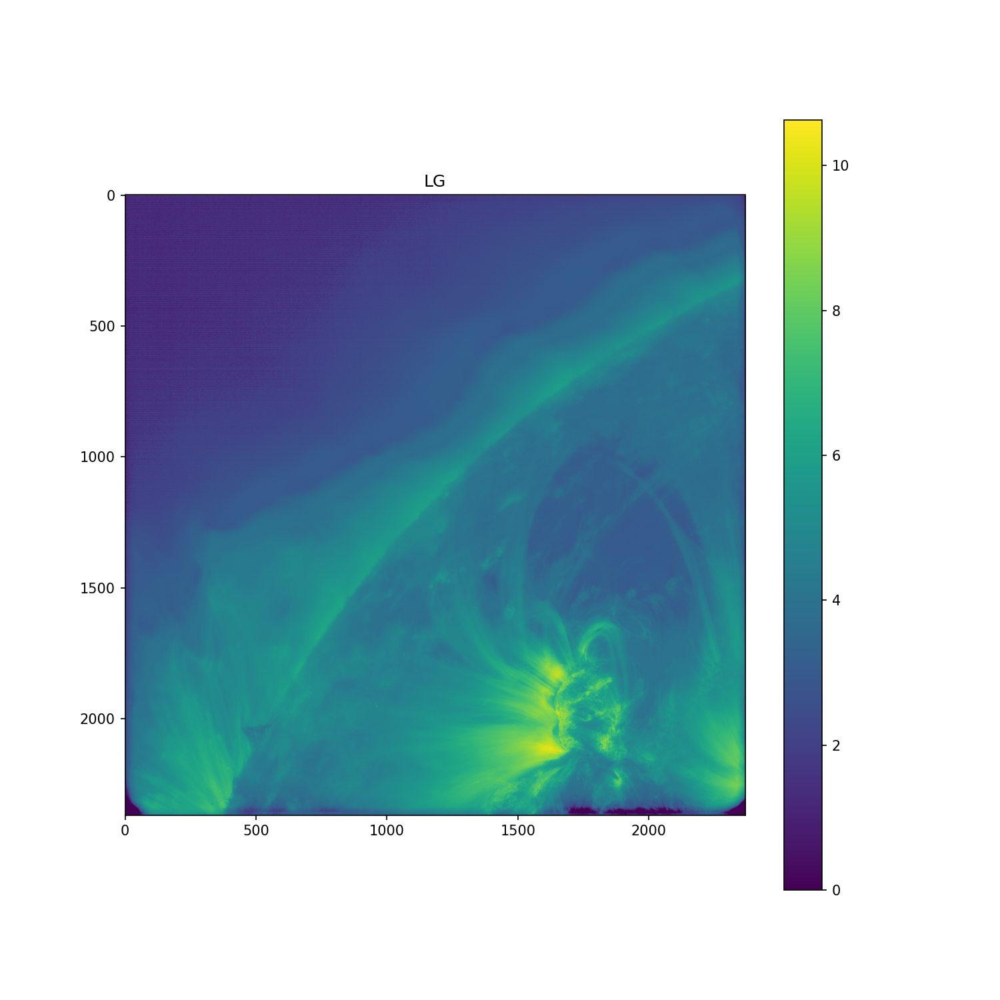

In [84]:
showimg(lg[-1].data, 'LG', power=0.3)

<IPython.core.display.Javascript object>


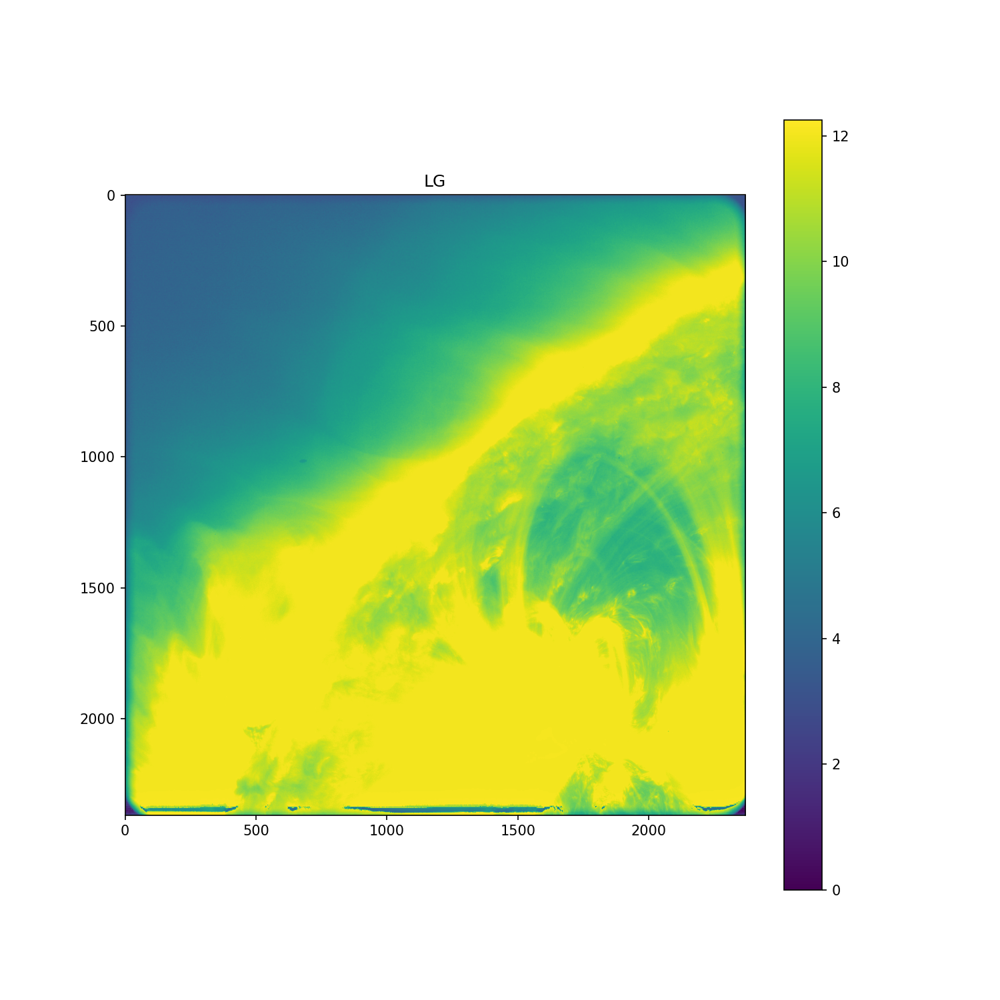

In [85]:
showimg(hg[-1].data, 'LG', power=0.3)

We can repeat the previous exercise by combining two more images from the mosaic taken at a different pointing location.

<IPython.core.display.Javascript object>


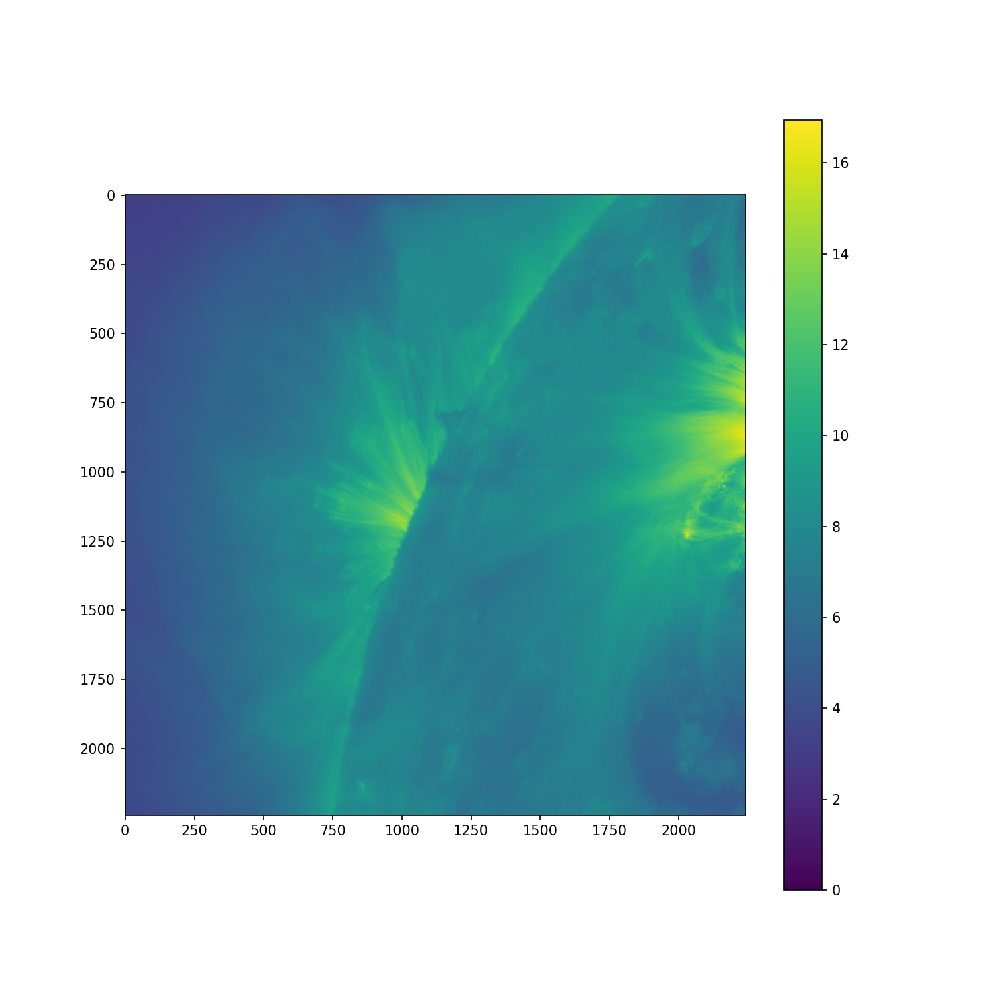

In [86]:
hg2 = fits.open('./data_mosaic/lights/solo_L1_eui-hrieuv174-image_20220307T071235241_V01.fits')
lg2 = fits.open('./data_mosaic/lights/solo_L1_eui-hrieuv174-image_20220307T071240241_V01.fits')

cal_hg2 = (hg2[-1].data.astype(np.float64) - data_dark_lg) / data_flat_lg
cal_lg2 = (lg2[-1].data.astype(np.float64) - data_dark_lg) / data_flat_lg
lg_multiplier2=find_multiplier(cal_lg, cal_hg)
lg_multiplier2
combined2 = combine(hg2[-1].data, cal_lg2, cal_hg2, gain_threshold=3975, global_gain_hg=72, global_gain_lg=lg_multiplier2*72)
showimg(combined2,'', power=0.3)

Again the image looks very smooth, particularly compared to the original low- and high-gain data.

<IPython.core.display.Javascript object>


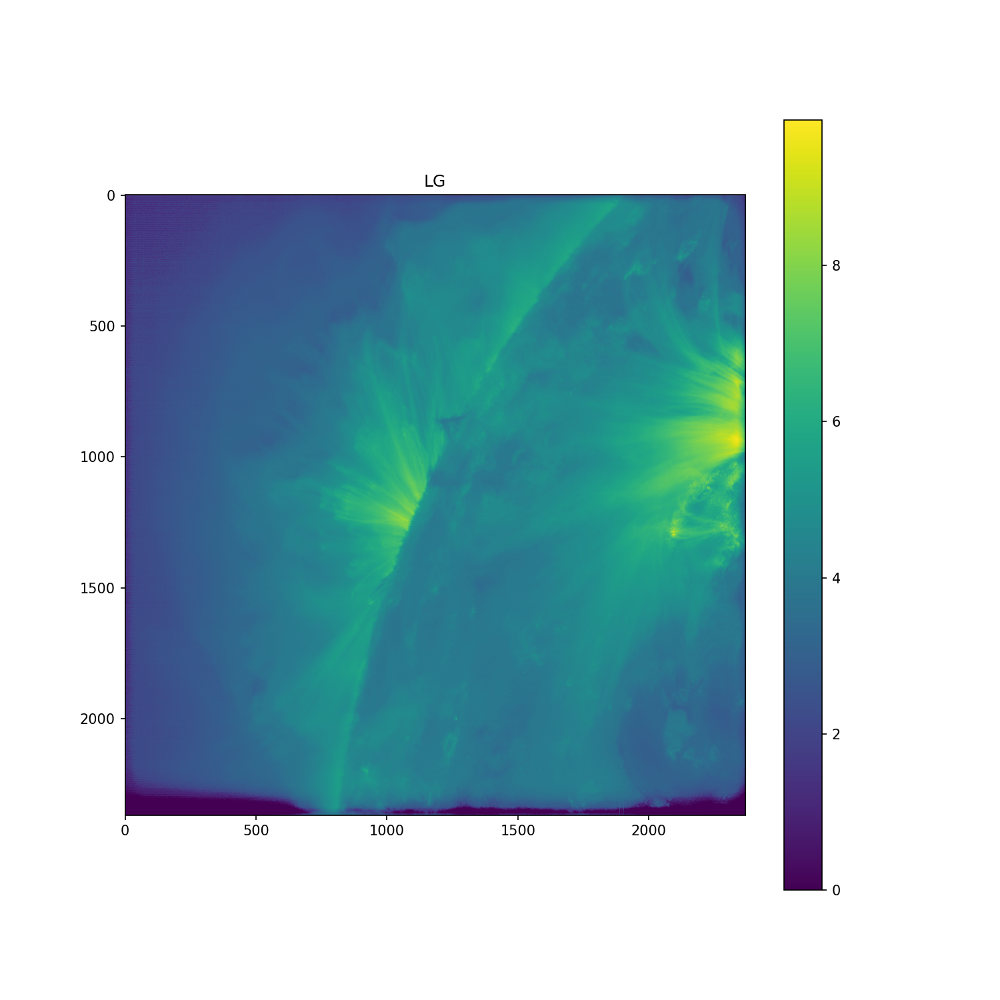

<IPython.core.display.Javascript object>


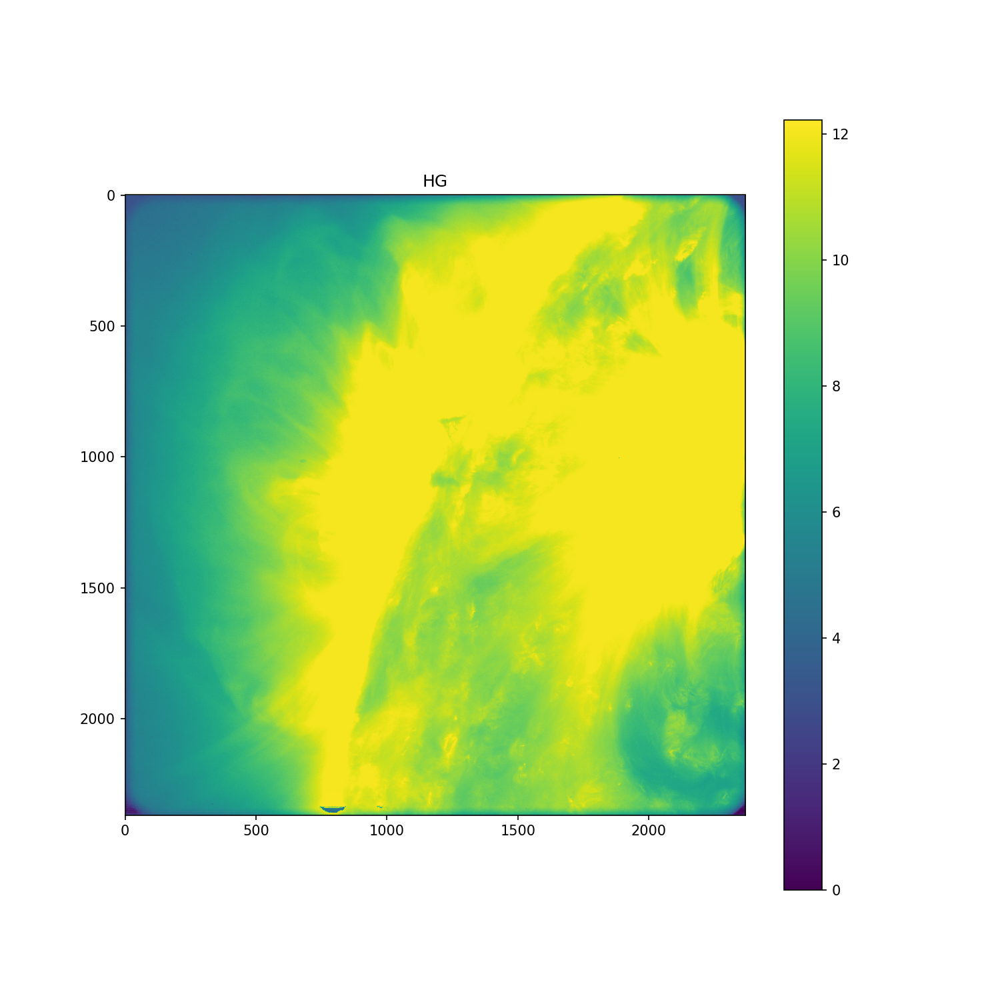

In [87]:
showimg(lg2[-1].data, 'LG', power=0.3)
showimg(hg2[-1].data, 'HG', power=0.3)

We will create some helper function that will translate and rotate the images onto a big canvas, allowing us to build a mosaic image on the fly. Here we will only use the previously 'calibrated' images, but there are in total 5 x 5 positions of mosaic data available, and at each pointing position we took several low and high gain images.

In [88]:
def rotate(origin, point, angle):
    """
    Rotate a point counterclockwise by a given angle (rad) around some origin.
    """
    ox, oy = origin
    px, py = point
    cos_angle = np.cos(angle)
    sin_angle = np.sin(angle)

    qx = ox + cos_angle * (px - ox) - sin_angle * (py - oy)
    qy = oy + sin_angle * (px - ox) + cos_angle * (py - oy)
    return qx, qy

def awesome_transform_rotate_translate_scale(sunx,suny,crota,scale,midx,midy):
    """ Create affine transformation matrix for opencv  """

    input_pts  = np.float32([[sunx,suny], [sunx+1,suny], [sunx,suny+1]])
    p1a,p1b = midx,midy
    p2a,p2b = rotate( (midx,midy), (midx+scale, midy), np.deg2rad(crota)) 
    p3a,p3b = rotate( (midx,midy), (midx, midy+scale), np.deg2rad(crota)) 
    output_pts = np.float32([[p1a,p1b],[p2a,p2b],[p3a,p3b]])

    # Calculate the transformation matrix using cv2.getAffineTransform()
    M= cv2.getAffineTransform(input_pts , output_pts)
    return M

def translate(hdu, combined):
    # First calculate the sun center
    header          = hdu[-1].header
    euxcen_t        = header['CRPIX1'] - (header['CRVAL1'] / header['CDELT1'])
    euycen_t        = header['CRPIX2'] - (header['CRVAL2'] / header['CDELT2'])
    euxcen,euycen   = rotate((header['CRPIX1'], header['CRPIX2']), (euxcen_t, euycen_t), -np.deg2rad(header['CROTA']))
    newmat = awesome_transform_rotate_translate_scale(euxcen,header['NAXIS2']-euycen,-header['CROTA'], 1.0, 2048*3,2048*3)
    translated_image = cv2.warpAffine(np.flipud(combined), newmat, (2048*6,2048*6), flags=cv2.INTER_NEAREST)
    return translated_image


We place the first combined image onto our canvas

In [89]:
a = translate(lg, combined)

<IPython.core.display.Javascript object>


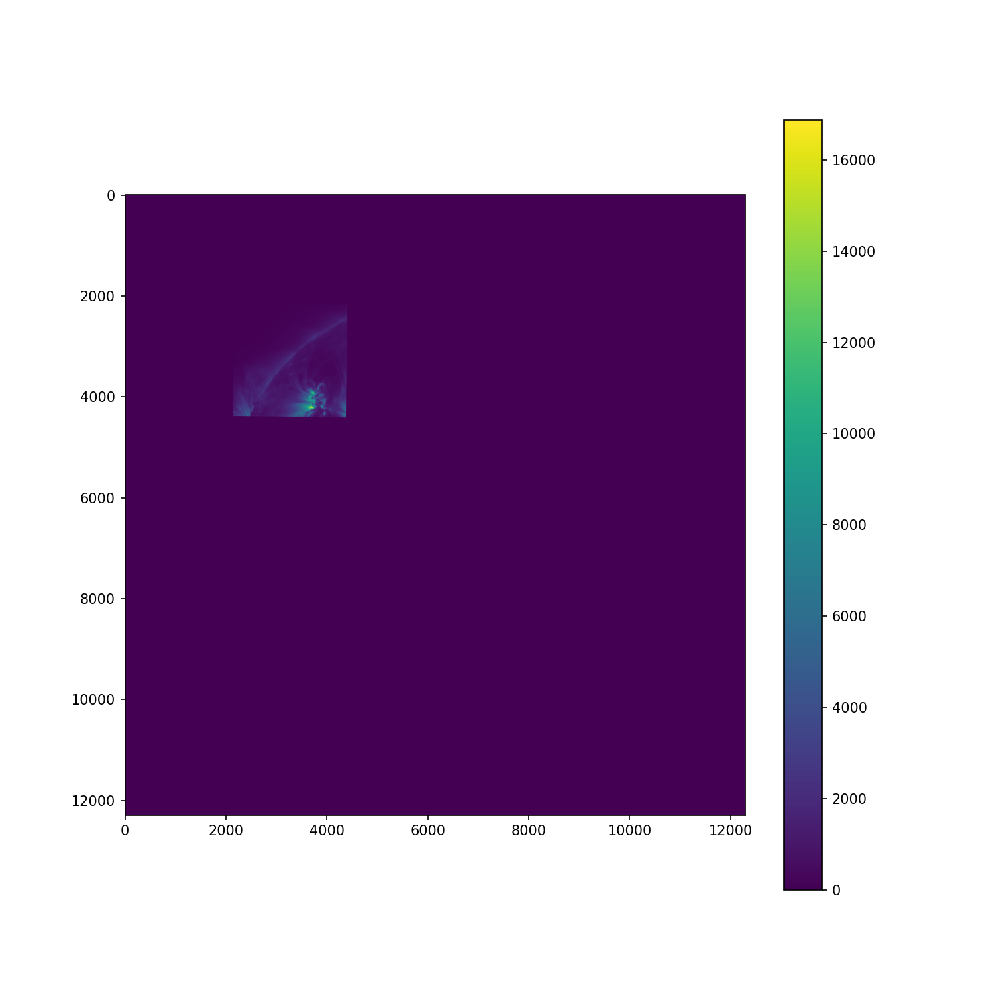

In [90]:
showimg(a,'', flip=False)

And our second one..

<IPython.core.display.Javascript object>


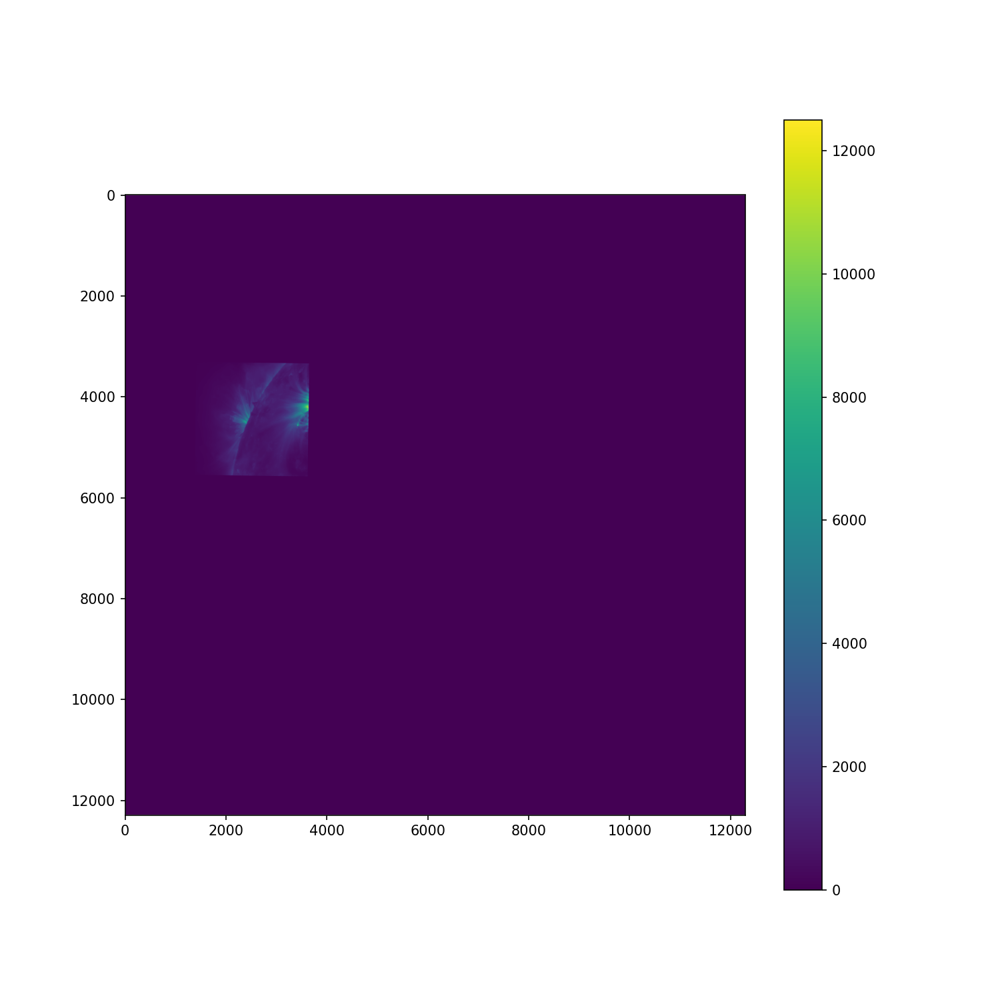

In [91]:
b = translate(lg2, combined2)
showimg(b,'', flip=False)

And finally we combine the two images in a very basic way and show the results!

<IPython.core.display.Javascript object>


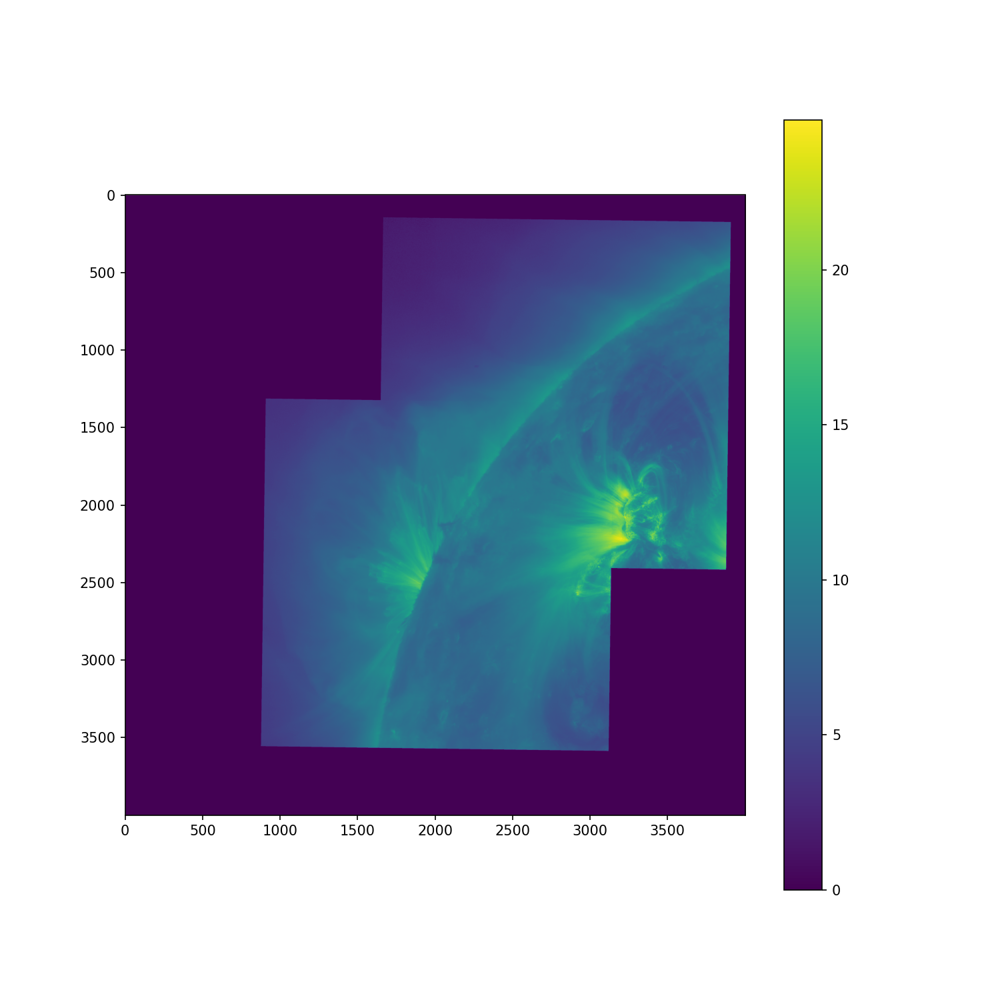

In [92]:
mosaic = a
mask = b > 0
mosaic[mask] = b[mask]
showimg(mosaic[2000:6000,500:4500],'',power=0.33, flip=False)

By processing more of the low and high-gain images, we could carry on to make an entire mosaic. We could get more fancy with:
- Merging neighboring panels together in a smart way
- Fixing the gummy bear artifact and or remaining dead/hot pixels
- Improve the gain combination procedure

..  but we will save that for another time.